In [8]:
!pip install -q ultralytics

In [9]:
import os
import cv2
import requests
from PIL import Image
import torch
from ultralytics import YOLO
from pathlib import Path

In [10]:
def check_gpu():
    if torch.cuda.is_available():
        print(f"GPU is available. Using device: {torch.cuda.get_device_name(0)}")
    else:
        print("GPU is not available. The model will run on the CPU, which will be slower.")

check_gpu()

GPU is available. Using device: Tesla T4


In [11]:
print("\nLoading pre-trained YOLOv8 model...")
model = YOLO('yolov8n.pt')
print("Model loaded successfully.")


Loading pre-trained YOLOv8 model...
Model loaded successfully.


In [12]:
image_urls = [
    "https://images.pexels.com/photos/3361739/pexels-photo-3361739.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/1056251/pexels-photo-1056251.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/374845/pexels-photo-374845.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/262047/pexels-photo-262047.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/4846437/pexels-photo-4846437.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/1619690/pexels-photo-1619690.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/6758775/pexels-photo-6758775.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/46798/the-ball-stadion-football-the-pitch-46798.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/3184398/pexels-photo-3184398.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/58997/pexels-photo-58997.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/2714722/pexels-photo-2714722.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/1424538/pexels-photo-1424538.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/165505/pexels-photo-165505.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/1529350/pexels-photo-1529350.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/1454806/pexels-photo-1454806.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/170811/pexels-photo-170811.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/792345/pexels-photo-792345.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/819737/pexels-photo-819737.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/34085/pexels-photo.jpg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1",
    "https://images.pexels.com/photos/4467127/pexels-photo-4467127.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1"
]

def download_image(url, save_path):
    """Downloads an image from a URL and saves it."""
    try:
        response = requests.get(url, stream=True)
        response.raise_for_status()
        with open(save_path, 'wb') as f:
            for chunk in response.iter_content(chunk_size=8192):
                f.write(chunk)
        return save_path
    except requests.exceptions.RequestException as e:
        print(f"Error downloading {url}: {e}")
        return None

In [13]:
# Create a directory to store images
image_dir = Path("test_images")
image_dir.mkdir(exist_ok=True)

# Download all images and store their paths
image_paths = []
print("\nDownloading test images...")
for i, url in enumerate(image_urls):
    file_path = image_dir / f"image_{i+1}.jpg"
    if download_image(url, file_path):
        image_paths.append(file_path)
print(f"Successfully downloaded {len(image_paths)} images.")


Successfully downloaded 20 images.



Running object detection on all images...
Detection complete.

0: 640x640 1 dog, 5.1ms
1: 640x640 1 cat, 5.1ms
2: 640x640 4 persons, 1 bench, 1 dog, 1 cup, 1 bed, 2 cell phones, 5.1ms
3: 640x640 1 cup, 9 chairs, 1 potted plant, 1 dining table, 5.1ms
4: 640x640 1 bird, 1 chair, 2 potted plants, 1 vase, 5.1ms
5: 640x640 1 dog, 1 tie, 1 frisbee, 5.1ms
6: 640x640 5 chairs, 2 couchs, 2 dining tables, 2 vases, 5.1ms
7: 640x640 1 kite, 5.1ms
8: 640x640 8 persons, 1 tie, 5.1ms
9: 640x640 1 person, 1 dog, 5.1ms
10: 640x640 1 pizza, 1 dining table, 5.1ms
11: 640x640 1 person, 5.1ms
12: 640x640 2 persons, 1 frisbee, 1 surfboard, 5.1ms
13: 640x640 1 person, 5.1ms
14: 640x640 1 bed, 5.1ms
15: 640x640 1 car, 1 truck, 5.1ms
16: 640x640 1 laptop, 2 mouses, 2 cell phones, 5.1ms
17: 640x640 1 person, 5.1ms
18: 640x640 (no detections), 5.1ms
19: 640x640 2 vases, 5.1ms


===== Results for Image 1 (image_1.jpg) =====


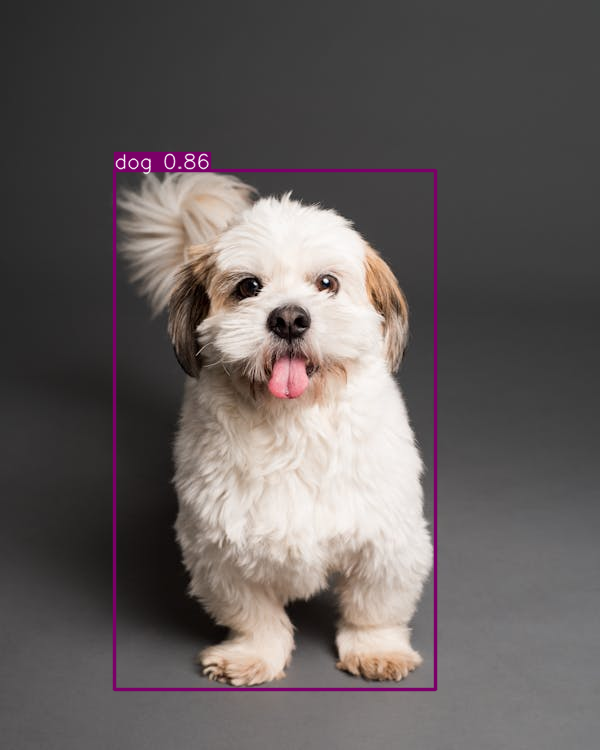


--- Detection Details ---
- Detected: dog (Confidence: 0.86)


===== Results for Image 2 (image_2.jpg) =====


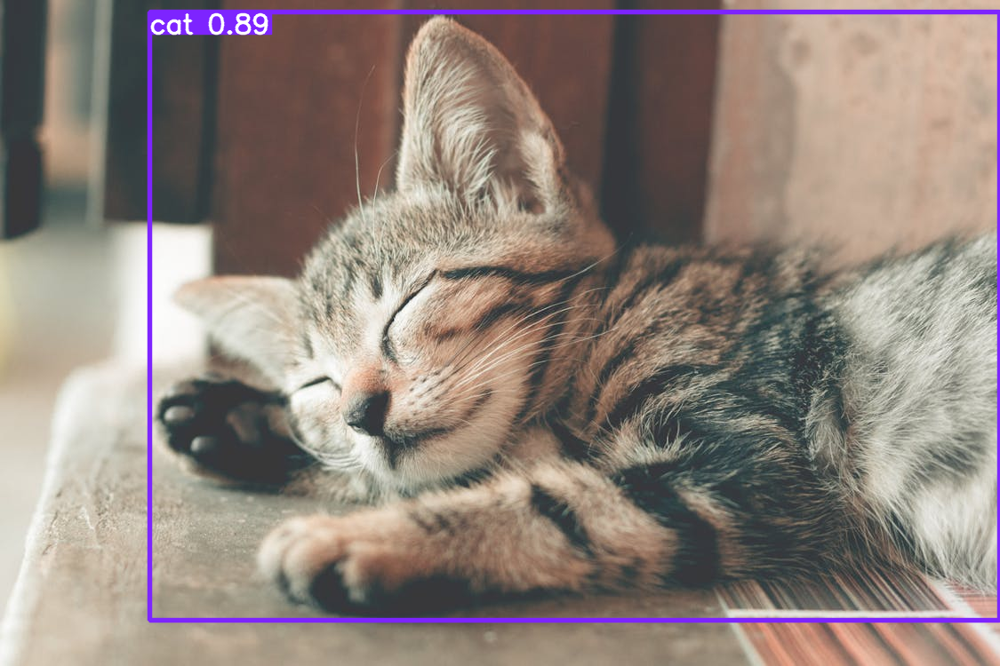


--- Detection Details ---
- Detected: cat (Confidence: 0.89)


===== Results for Image 3 (image_3.jpg) =====


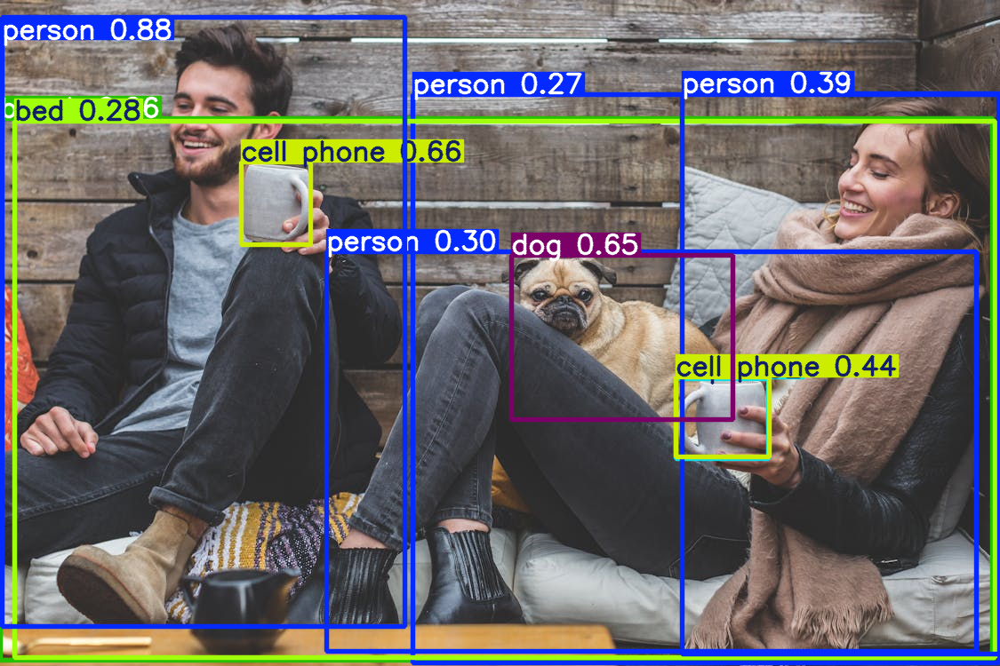


--- Detection Details ---
- Detected: person (Confidence: 0.88)
- Detected: cell phone (Confidence: 0.66)
- Detected: dog (Confidence: 0.65)
- Detected: cell phone (Confidence: 0.44)
- Detected: person (Confidence: 0.39)
- Detected: cup (Confidence: 0.32)
- Detected: person (Confidence: 0.30)
- Detected: bed (Confidence: 0.28)
- Detected: person (Confidence: 0.27)
- Detected: bench (Confidence: 0.26)


===== Results for Image 4 (image_4.jpg) =====


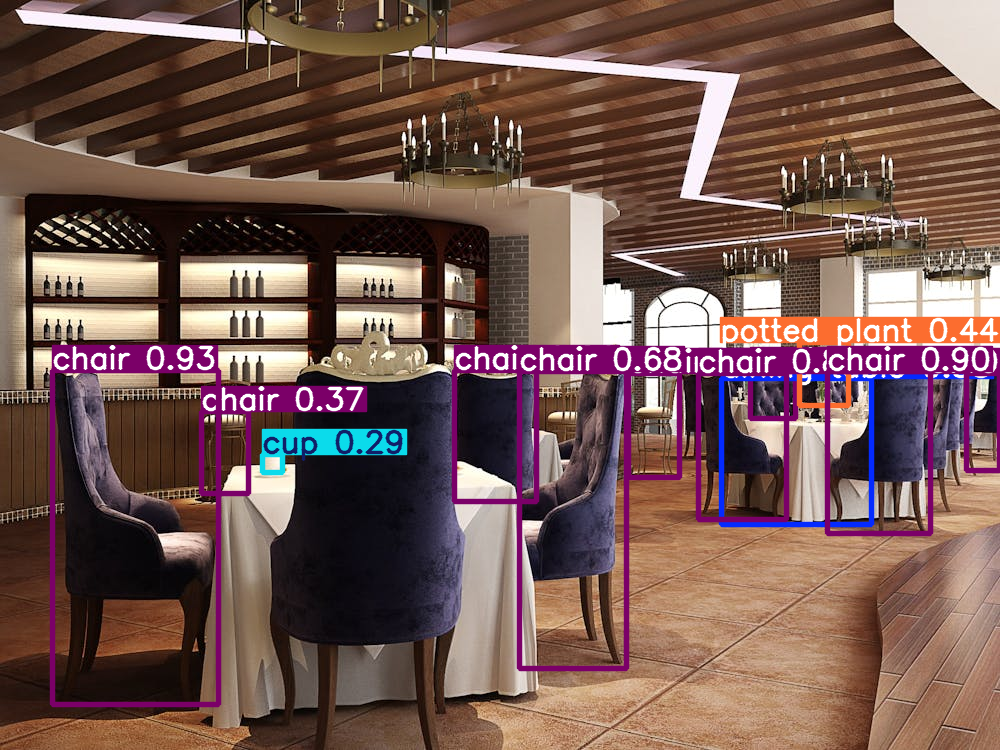


--- Detection Details ---
- Detected: chair (Confidence: 0.93)
- Detected: chair (Confidence: 0.90)
- Detected: chair (Confidence: 0.86)
- Detected: chair (Confidence: 0.68)
- Detected: potted plant (Confidence: 0.44)
- Detected: chair (Confidence: 0.40)
- Detected: chair (Confidence: 0.40)
- Detected: chair (Confidence: 0.37)
- Detected: dining table (Confidence: 0.33)
- Detected: cup (Confidence: 0.29)
- Detected: chair (Confidence: 0.27)
- Detected: chair (Confidence: 0.26)


===== Results for Image 5 (image_5.jpg) =====


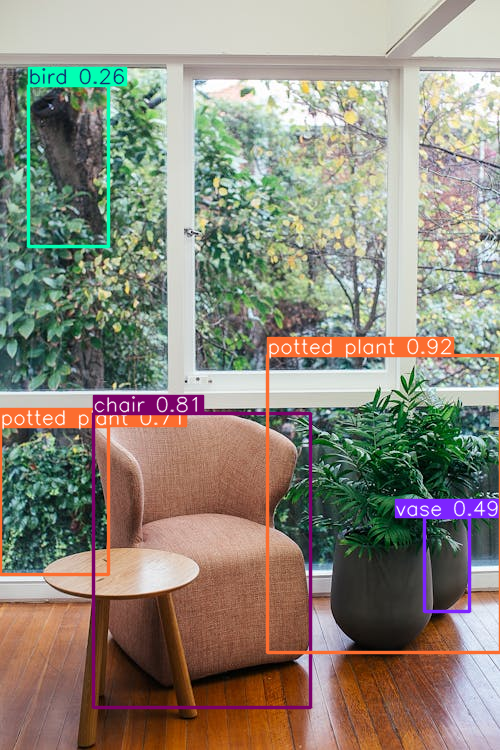


--- Detection Details ---
- Detected: potted plant (Confidence: 0.92)
- Detected: chair (Confidence: 0.81)
- Detected: potted plant (Confidence: 0.71)
- Detected: vase (Confidence: 0.49)
- Detected: bird (Confidence: 0.26)


===== Results for Image 6 (image_6.jpg) =====


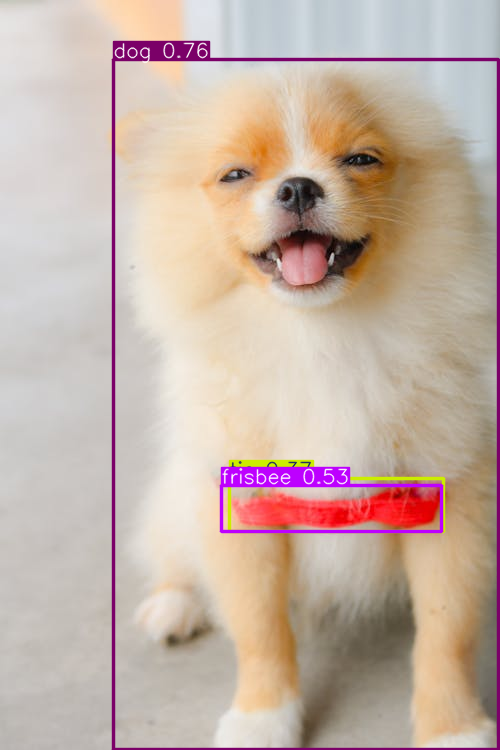


--- Detection Details ---
- Detected: dog (Confidence: 0.76)
- Detected: frisbee (Confidence: 0.53)
- Detected: tie (Confidence: 0.37)


===== Results for Image 7 (image_7.jpg) =====


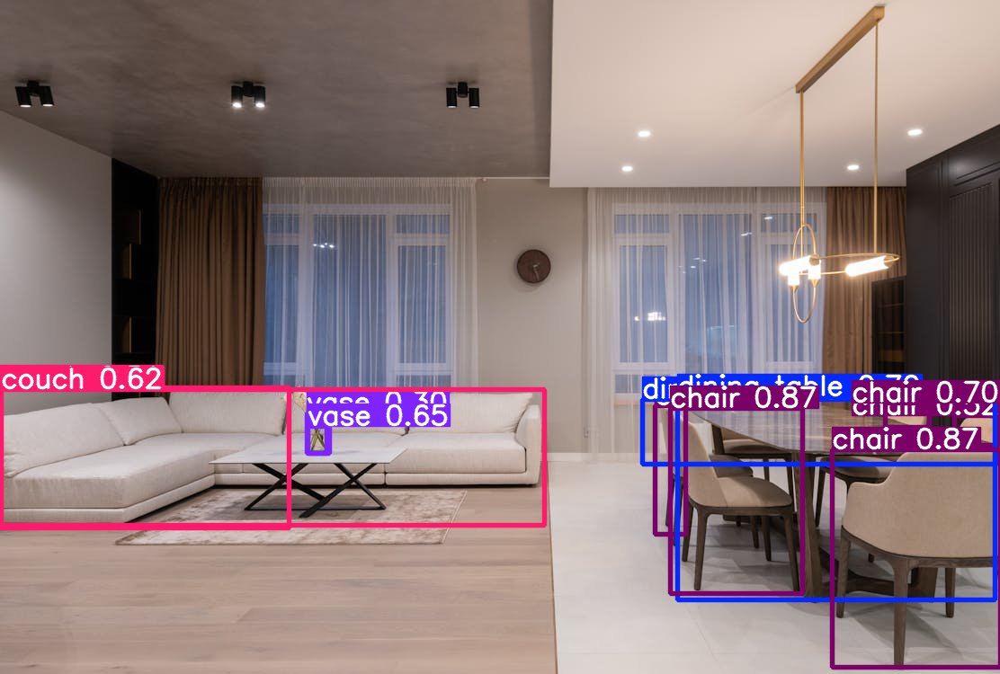


--- Detection Details ---
- Detected: chair (Confidence: 0.87)
- Detected: chair (Confidence: 0.87)
- Detected: chair (Confidence: 0.70)
- Detected: dining table (Confidence: 0.70)
- Detected: vase (Confidence: 0.65)
- Detected: couch (Confidence: 0.62)
- Detected: chair (Confidence: 0.52)
- Detected: couch (Confidence: 0.51)
- Detected: dining table (Confidence: 0.38)
- Detected: vase (Confidence: 0.30)
- Detected: chair (Confidence: 0.29)


===== Results for Image 8 (image_8.jpg) =====


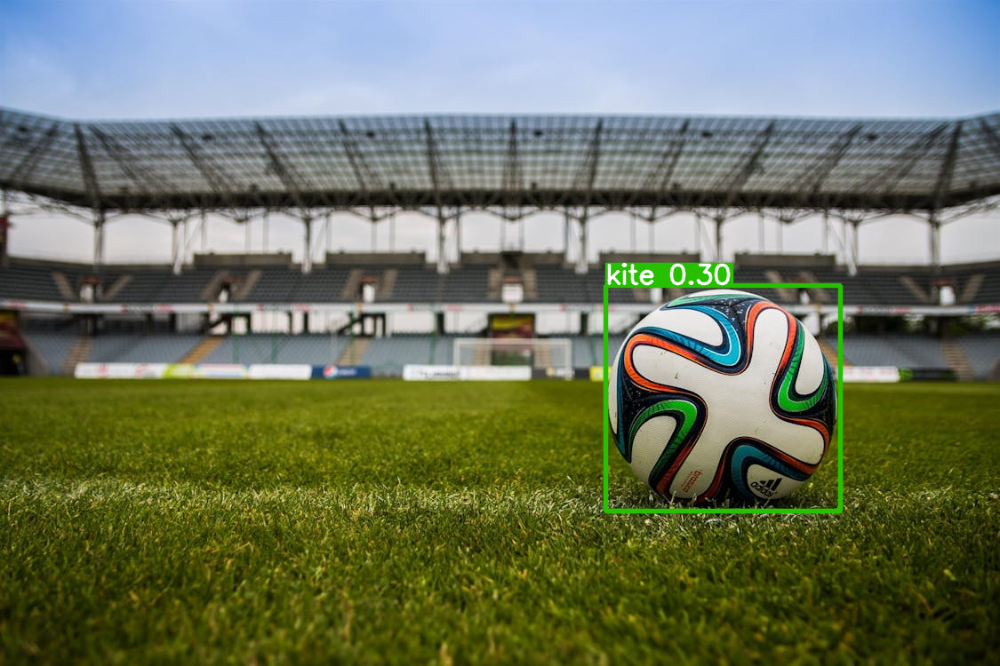


--- Detection Details ---
- Detected: kite (Confidence: 0.30)


===== Results for Image 9 (image_9.jpg) =====


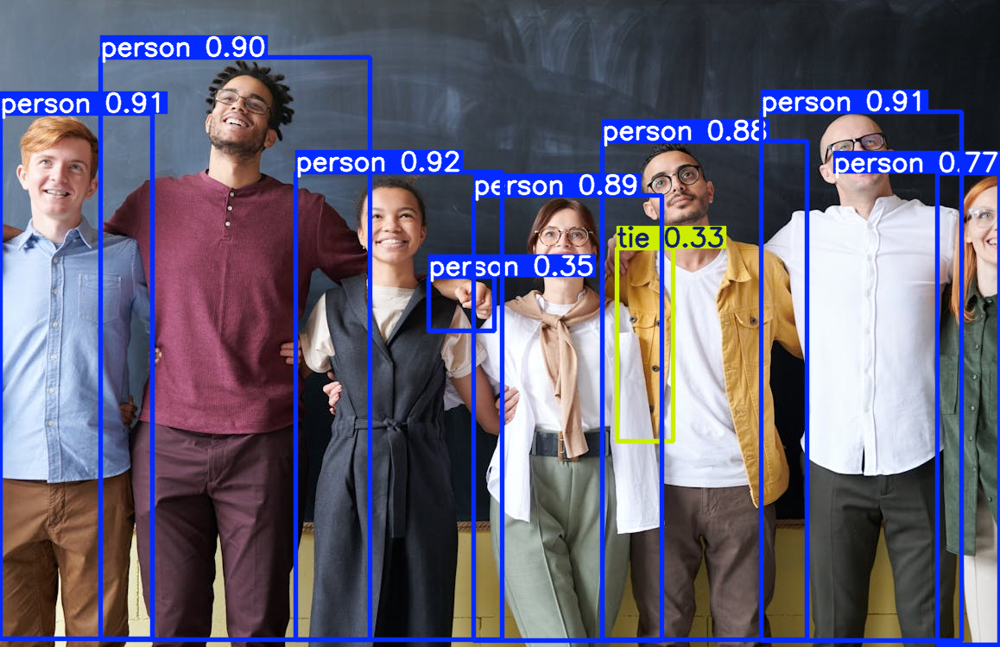


--- Detection Details ---
- Detected: person (Confidence: 0.92)
- Detected: person (Confidence: 0.91)
- Detected: person (Confidence: 0.91)
- Detected: person (Confidence: 0.90)
- Detected: person (Confidence: 0.89)
- Detected: person (Confidence: 0.88)
- Detected: person (Confidence: 0.77)
- Detected: person (Confidence: 0.35)
- Detected: tie (Confidence: 0.33)


===== Results for Image 10 (image_10.jpg) =====


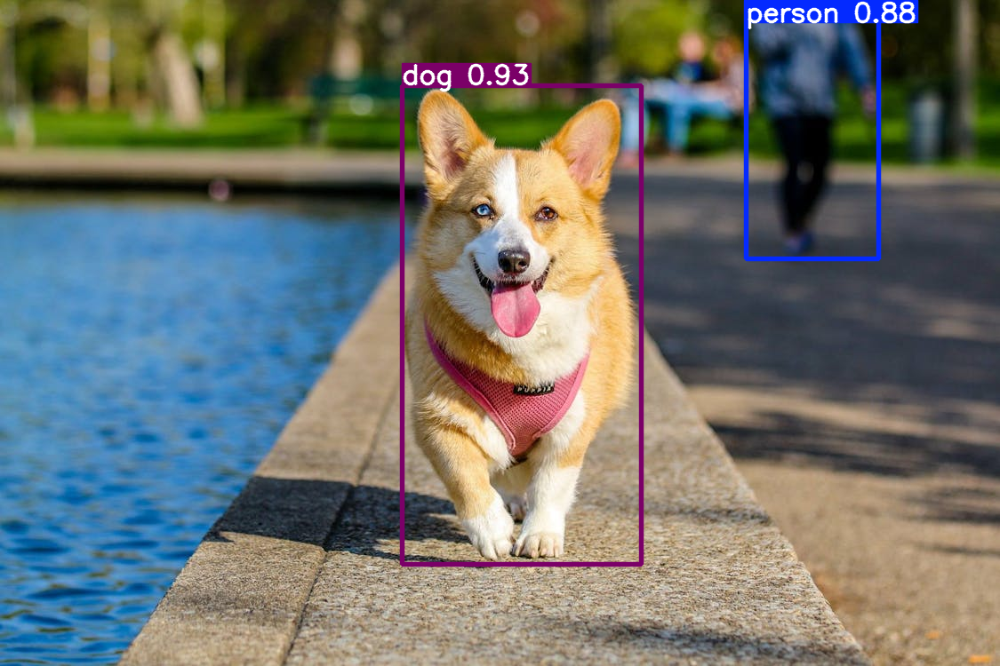


--- Detection Details ---
- Detected: dog (Confidence: 0.93)
- Detected: person (Confidence: 0.88)


===== Results for Image 11 (image_11.jpg) =====


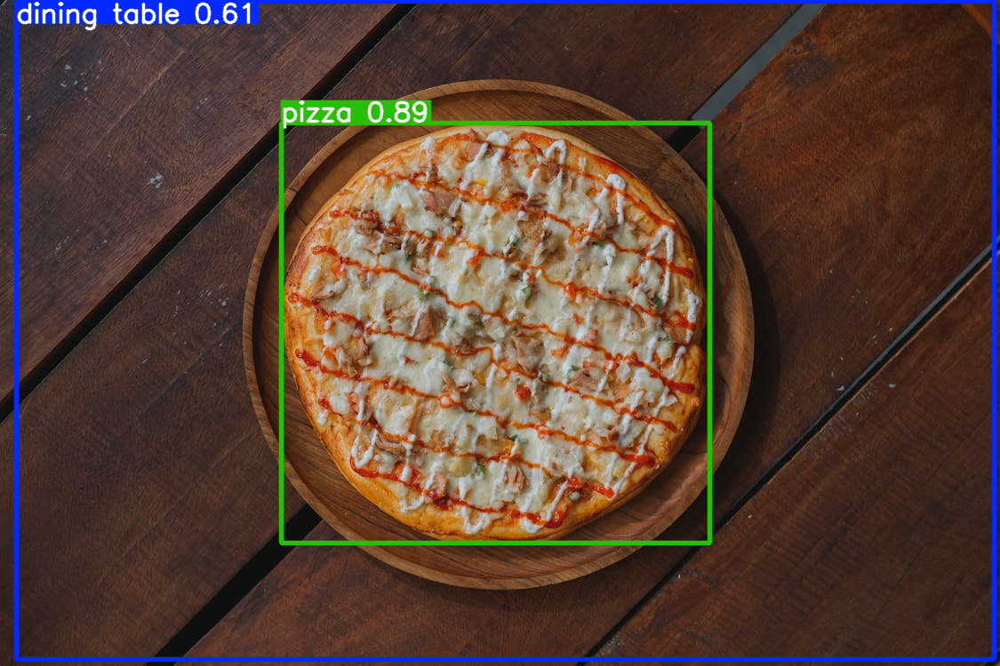


--- Detection Details ---
- Detected: pizza (Confidence: 0.89)
- Detected: dining table (Confidence: 0.61)


===== Results for Image 12 (image_12.jpg) =====


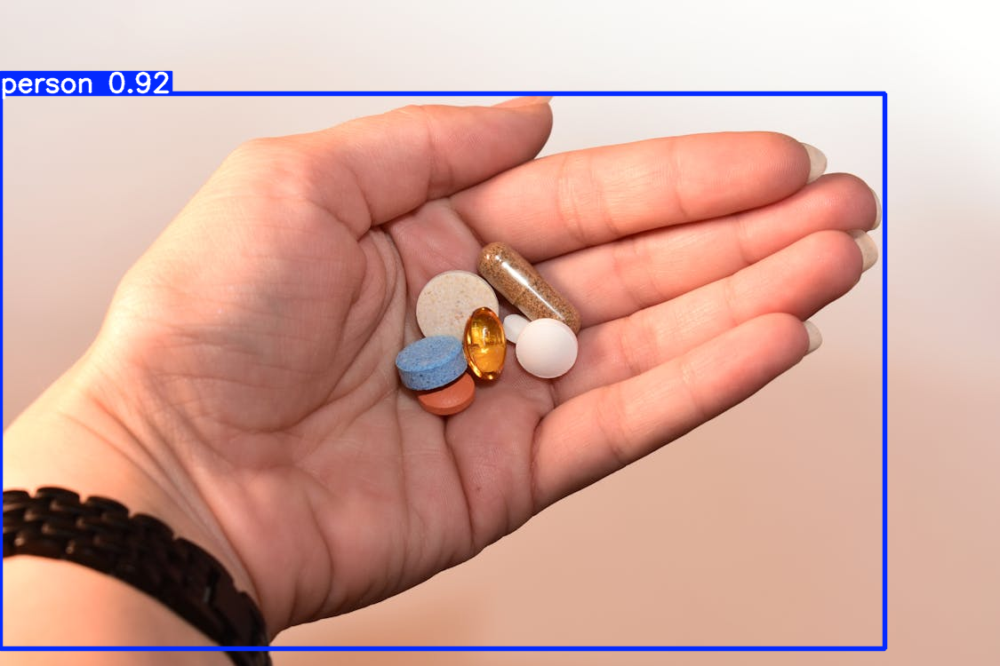


--- Detection Details ---
- Detected: person (Confidence: 0.92)


===== Results for Image 13 (image_13.jpg) =====


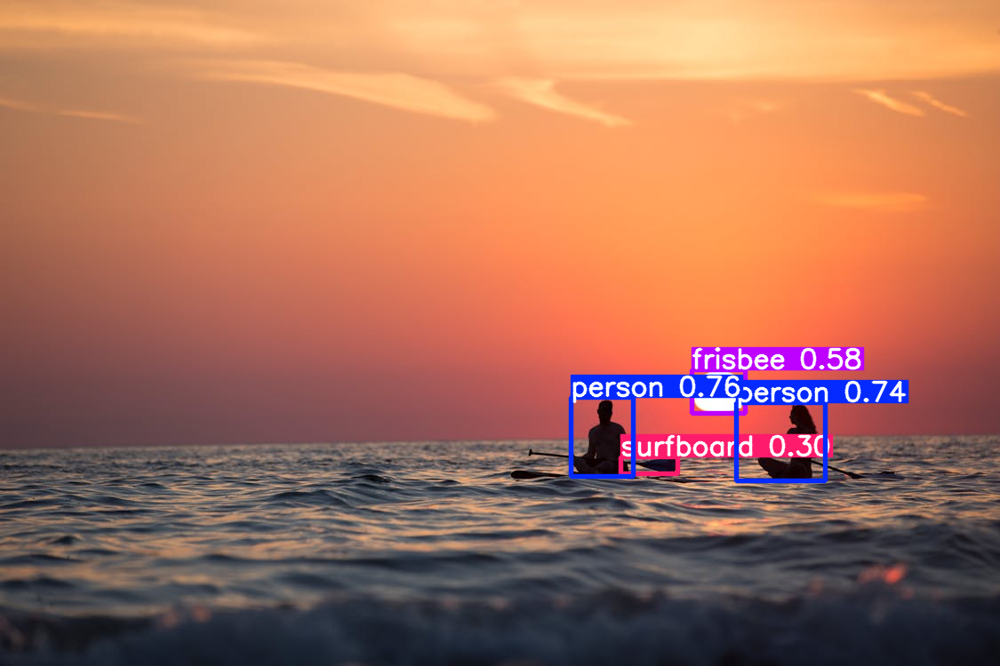


--- Detection Details ---
- Detected: person (Confidence: 0.76)
- Detected: person (Confidence: 0.74)
- Detected: frisbee (Confidence: 0.58)
- Detected: surfboard (Confidence: 0.30)


===== Results for Image 14 (image_14.jpg) =====


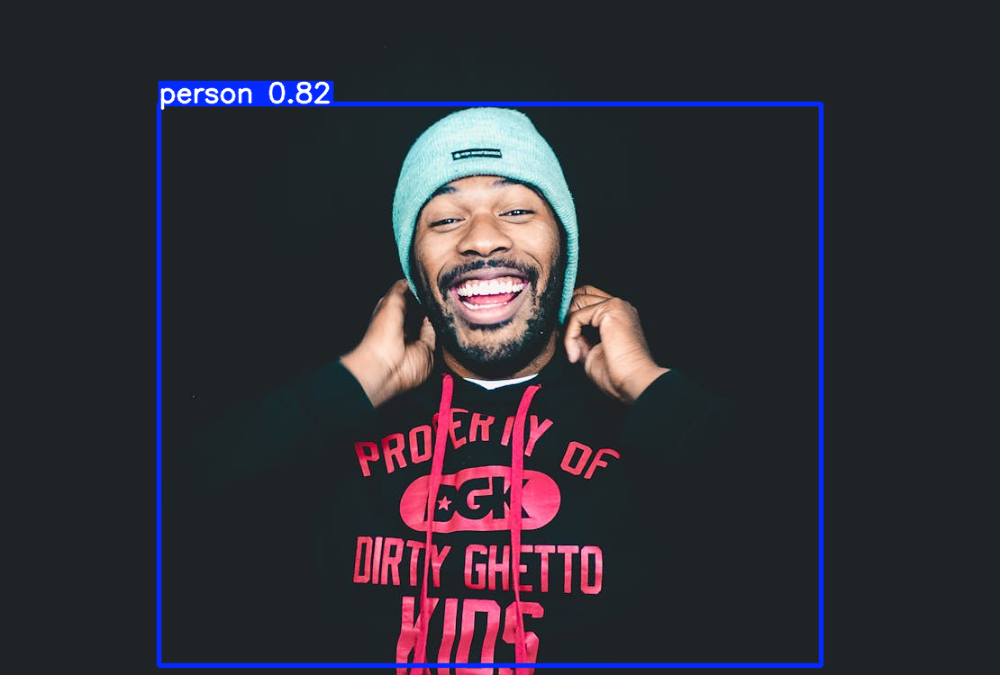


--- Detection Details ---
- Detected: person (Confidence: 0.82)


===== Results for Image 15 (image_15.jpg) =====


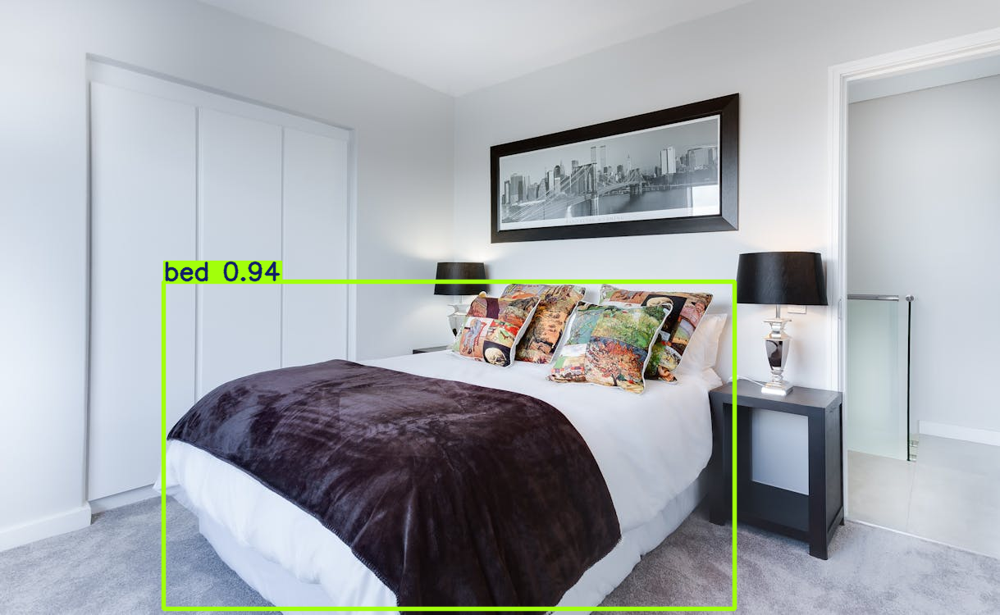


--- Detection Details ---
- Detected: bed (Confidence: 0.94)


===== Results for Image 16 (image_16.jpg) =====


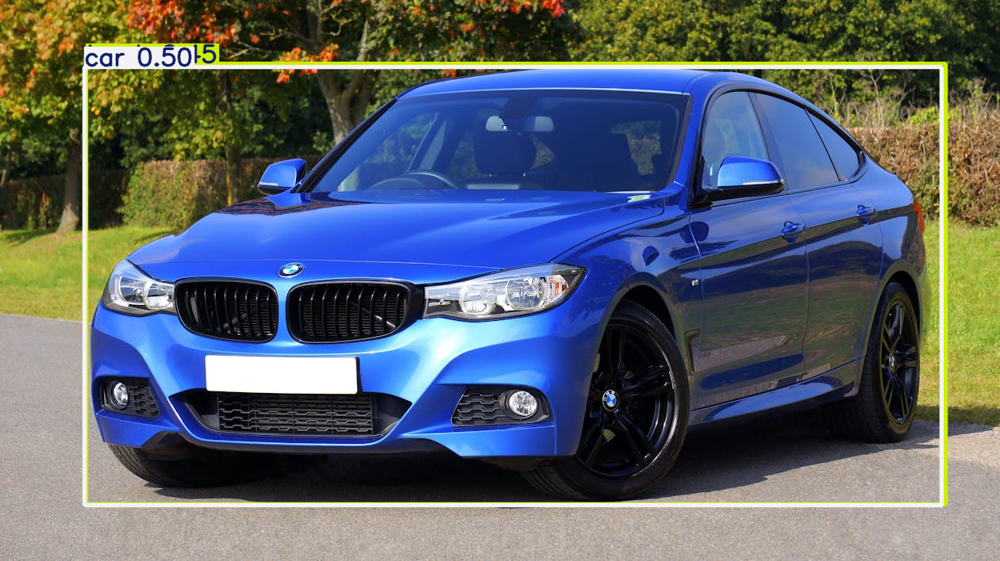


--- Detection Details ---
- Detected: car (Confidence: 0.50)
- Detected: truck (Confidence: 0.45)


===== Results for Image 17 (image_17.jpg) =====


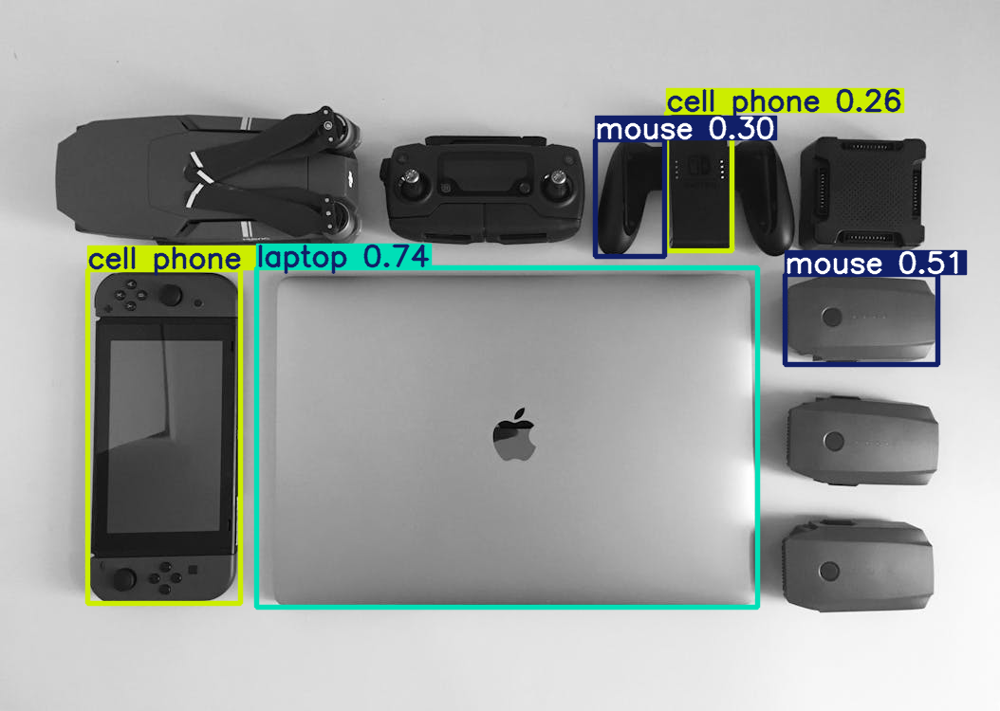


--- Detection Details ---
- Detected: laptop (Confidence: 0.74)
- Detected: cell phone (Confidence: 0.58)
- Detected: mouse (Confidence: 0.51)
- Detected: mouse (Confidence: 0.30)
- Detected: cell phone (Confidence: 0.26)


===== Results for Image 18 (image_18.jpg) =====


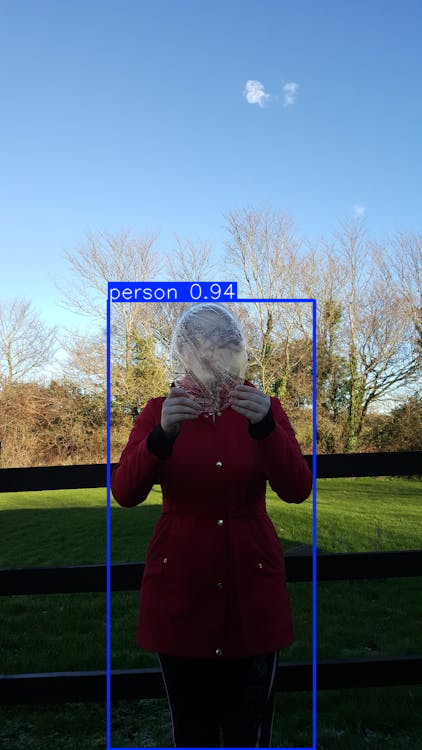


--- Detection Details ---
- Detected: person (Confidence: 0.94)


===== Results for Image 19 (image_19.jpg) =====


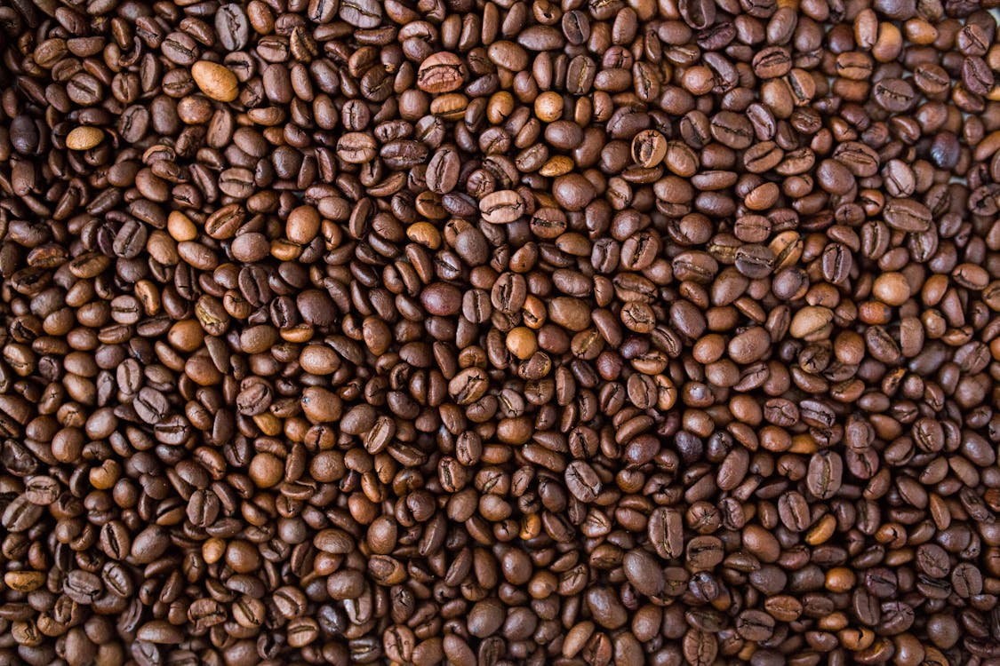


--- Detection Details ---
No objects were detected in this image.


===== Results for Image 20 (image_20.jpg) =====


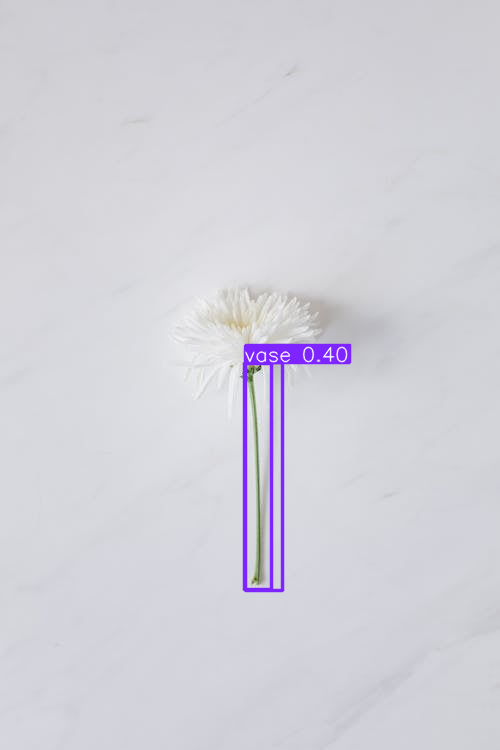


--- Detection Details ---
- Detected: vase (Confidence: 0.40)
- Detected: vase (Confidence: 0.28)
Speed: 4.8ms preprocess, 5.1ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


In [16]:
if image_paths:
    print("\nRunning object detection on all images...")
    # The `stream=True` option is more memory-efficient for many images.
    results_generator = model.predict(source=image_paths, stream=True)
    print("Detection complete.")

    # === 7. Process and Visualize the Results for Each Image ===
    # Import cv2_imshow from google.colab.patches for displaying images in canvas
    from google.colab.patches import cv2_imshow

    for i, results in enumerate(results_generator):
        print(f"\n\n===== Results for Image {i+1} ({image_paths[i].name}) =====")

        # Use the plot() method to get an image with bounding boxes
        result_image_array = results.plot()

        # Convert from BGR to RGB for display - this is not needed for cv2_imshow
        # result_image_rgb = cv2.cvtColor(result_image_array, cv2.COLOR_BGR2RGB)

        # Display the image in the canvas using cv2_imshow
        cv2_imshow(result_image_array)

        # Print details for each detected object in the current image
        print("\n--- Detection Details ---")
        class_names = results.names
        if len(results.boxes) > 0:
            for box in results.boxes:
                confidence = box.conf[0].cpu().numpy()
                class_id = int(box.cls[0].cpu().numpy())
                class_name = class_names[class_id]
                print(f"- Detected: {class_name} (Confidence: {confidence:.2f})")
        else:
            print("No objects were detected in this image.")
else:
    print("No images were downloaded. Cannot run detection.")

In [15]:
output_dir = Path("runs/detect/")
# Find the latest prediction directory
if output_dir.exists():
    predict_dirs = sorted([d for d in output_dir.iterdir() if d.is_dir() and d.name.startswith('predict')])
    if predict_dirs:
        latest_predict_dir = predict_dirs[-1]
        print(f"\n\nResult images have been saved to: {latest_predict_dir}")



0: 640x640 1 dog, 5.1ms
1: 640x640 1 cat, 5.1ms
2: 640x640 4 persons, 1 bench, 1 dog, 1 cup, 1 bed, 2 cell phones, 5.1ms
3: 640x640 1 cup, 9 chairs, 1 potted plant, 1 dining table, 5.1ms
4: 640x640 1 bird, 1 chair, 2 potted plants, 1 vase, 5.1ms
5: 640x640 1 dog, 1 tie, 1 frisbee, 5.1ms
6: 640x640 5 chairs, 2 couchs, 2 dining tables, 2 vases, 5.1ms
7: 640x640 1 kite, 5.1ms
8: 640x640 8 persons, 1 tie, 5.1ms
9: 640x640 1 person, 1 dog, 5.1ms
10: 640x640 1 pizza, 1 dining table, 5.1ms
11: 640x640 1 person, 5.1ms
12: 640x640 2 persons, 1 frisbee, 1 surfboard, 5.1ms
13: 640x640 1 person, 5.1ms
14: 640x640 1 bed, 5.1ms
15: 640x640 1 car, 1 truck, 5.1ms
16: 640x640 1 laptop, 2 mouses, 2 cell phones, 5.1ms
17: 640x640 1 person, 5.1ms
18: 640x640 (no detections), 5.1ms
19: 640x640 2 vases, 5.1ms
Speed: 3.4ms preprocess, 5.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Collected 20 result images.

Displaying results in a 2-column grid...


,
,
,
,
,
,
,
,
,
,

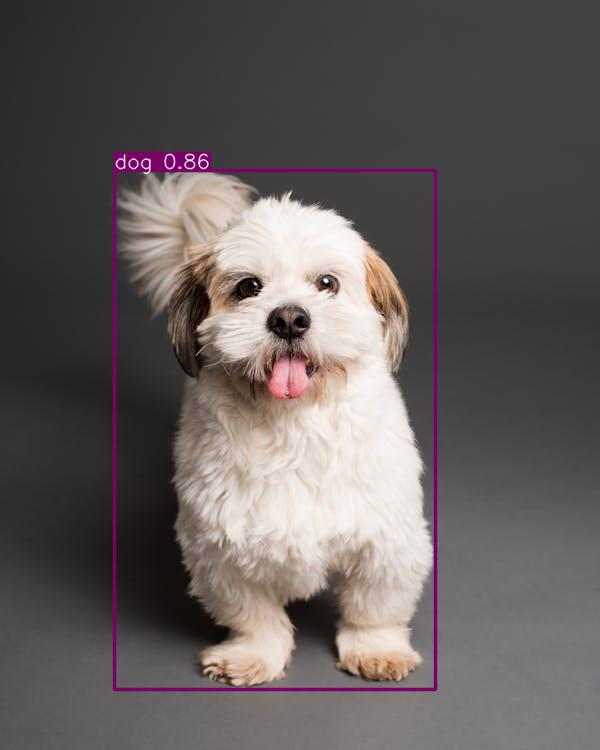
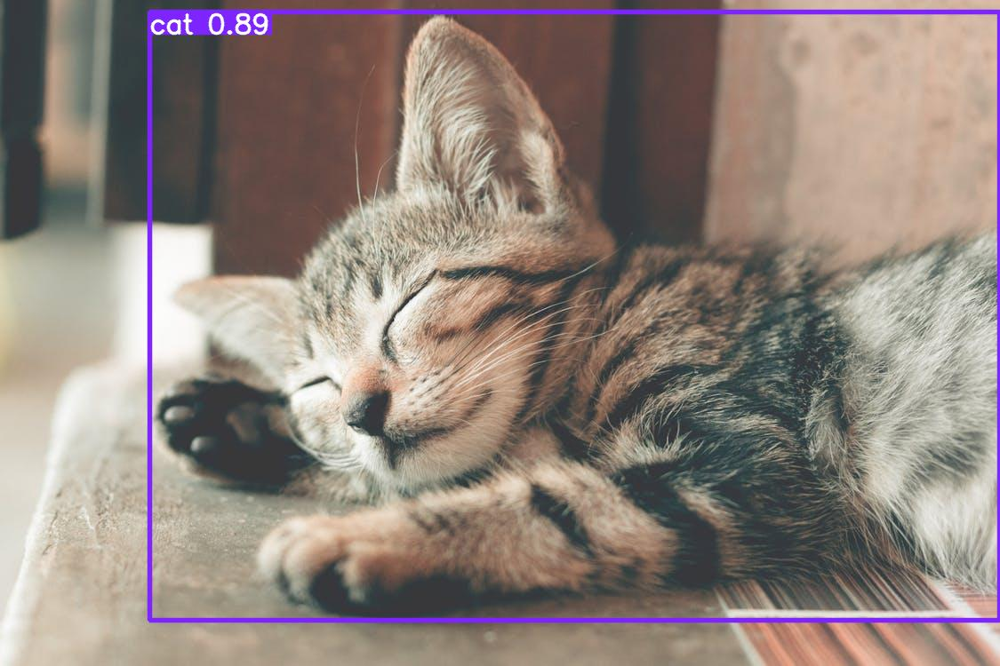
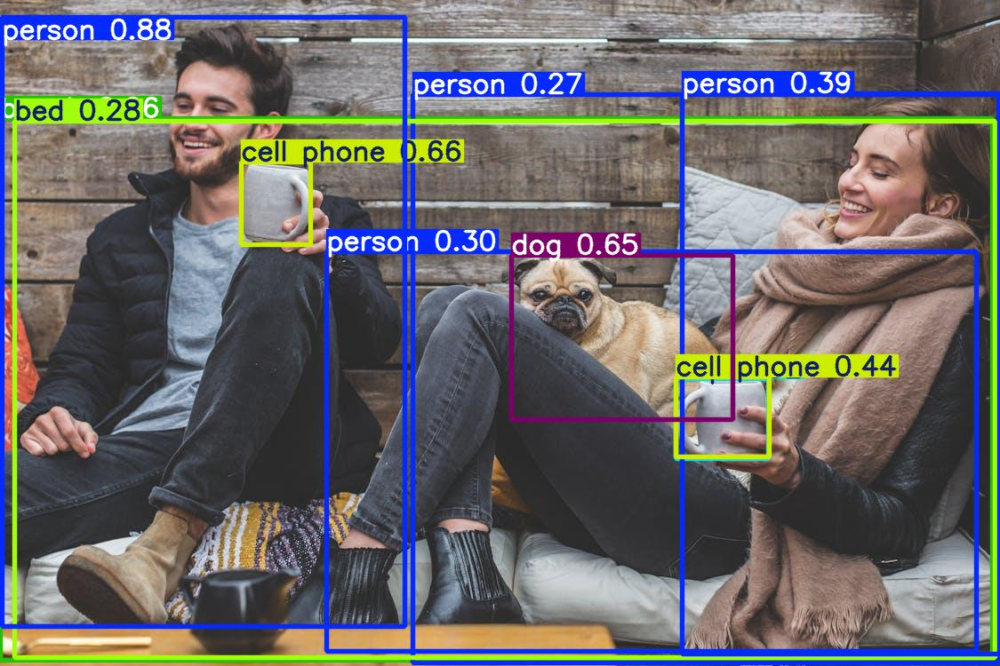
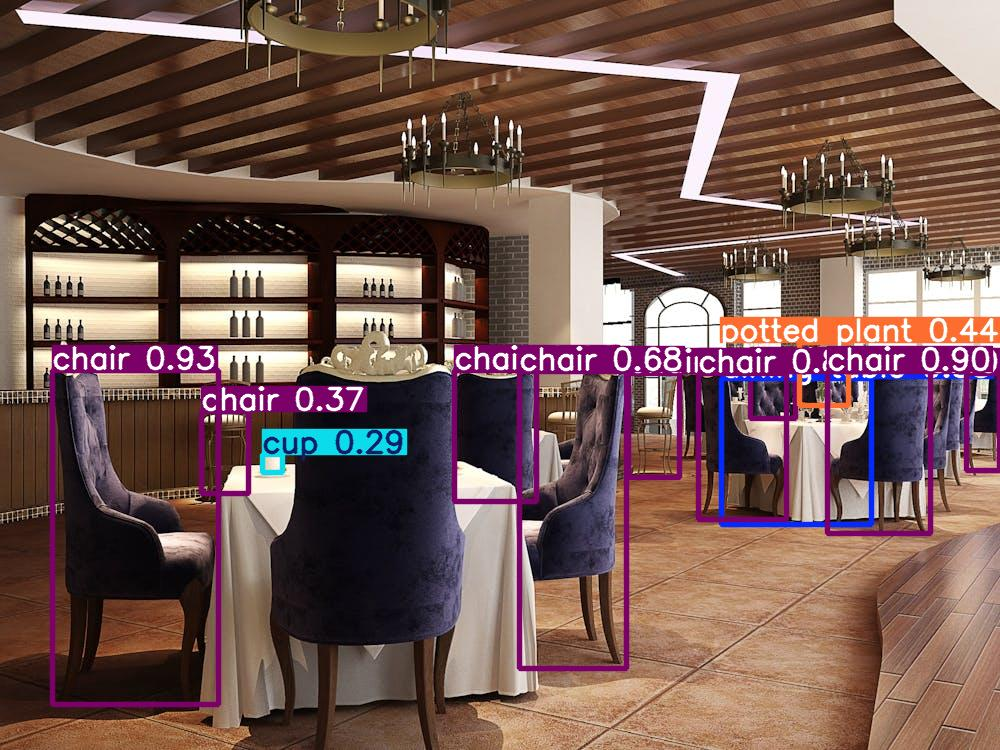
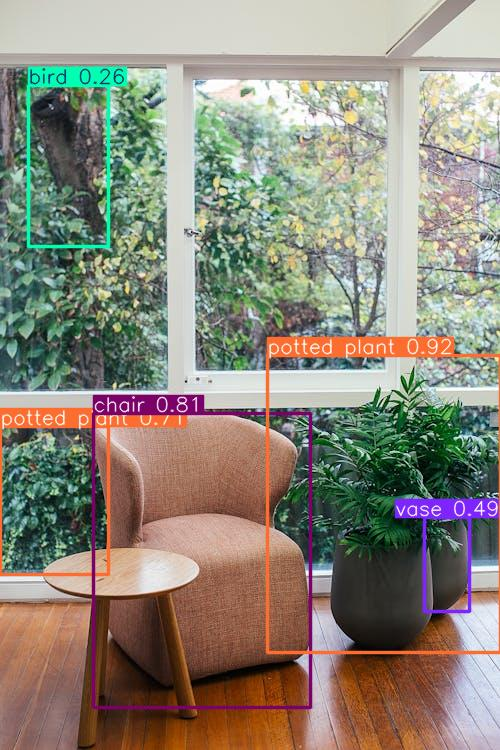
...
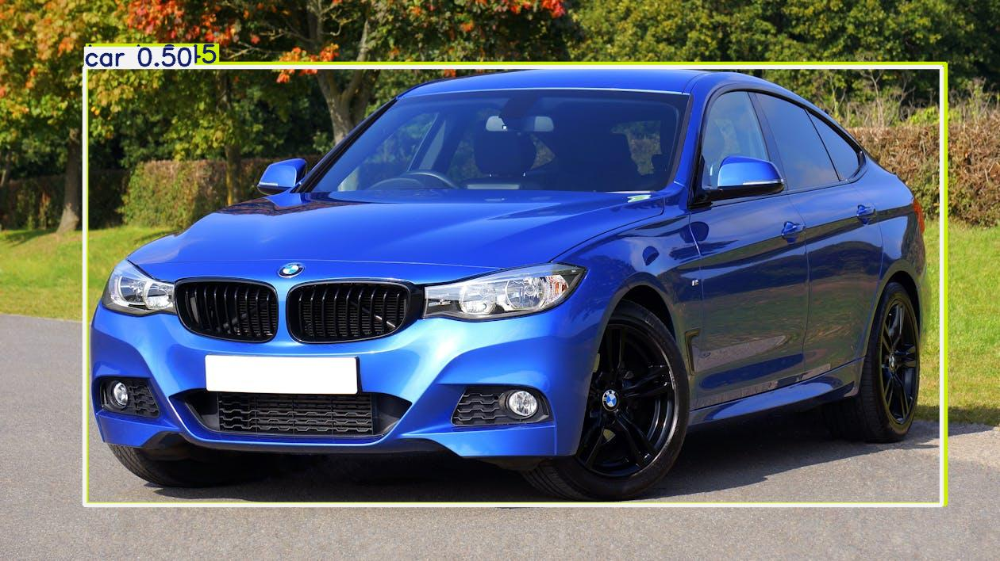
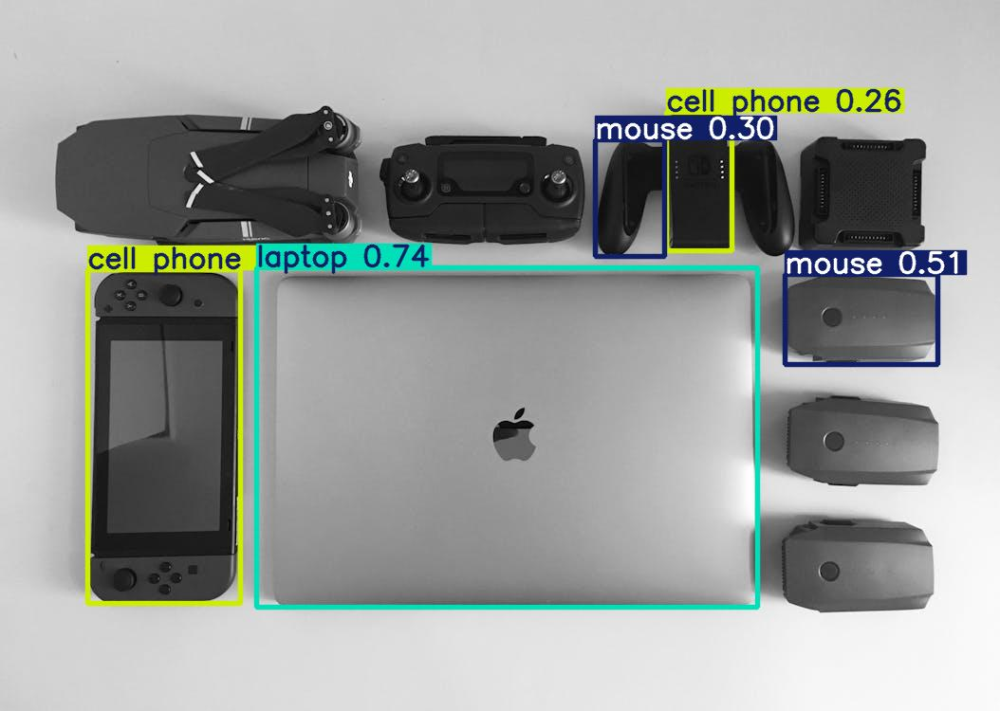
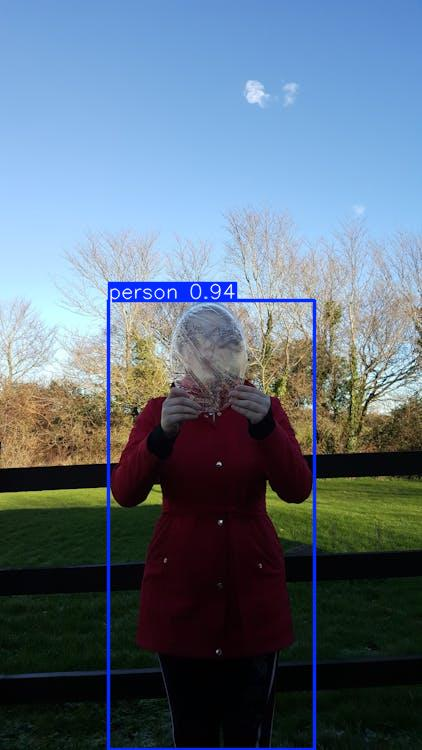
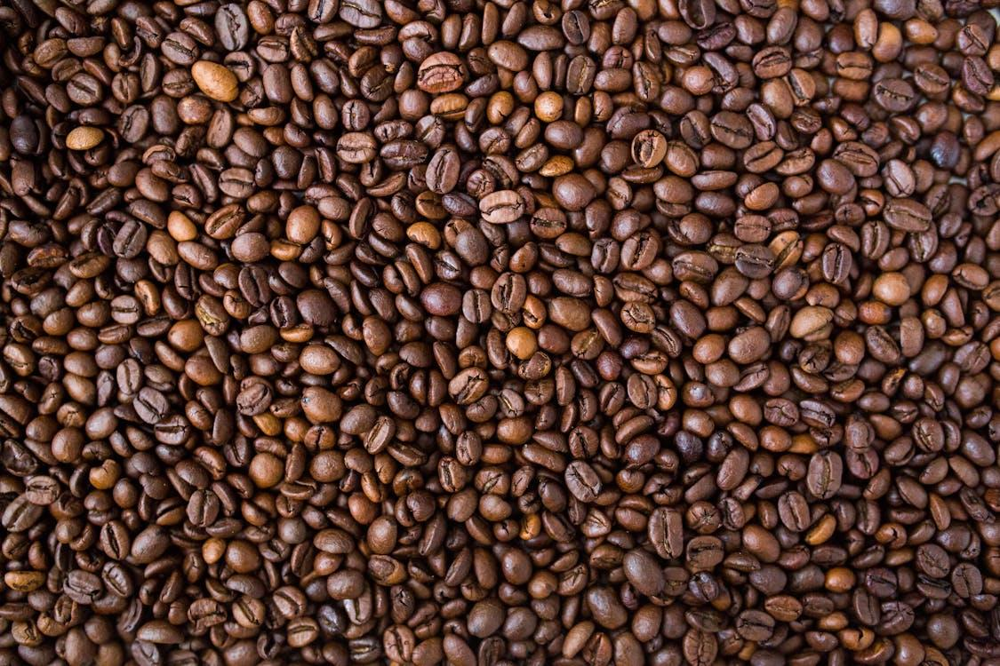
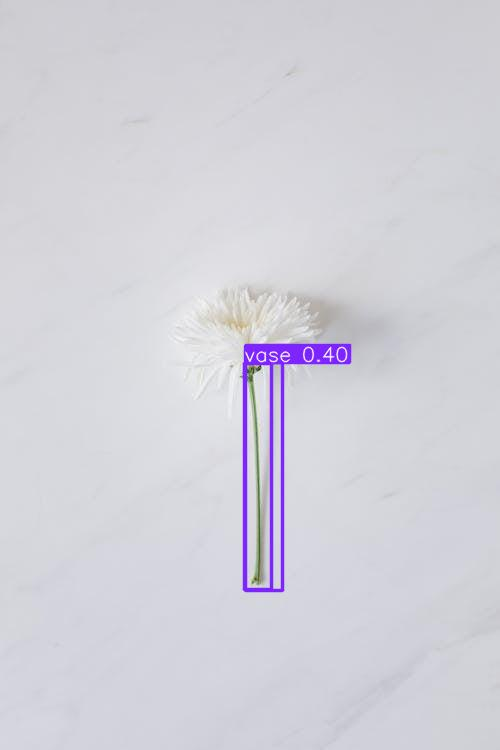

In [17]:
from IPython.display import display, HTML
import base64
from io import BytesIO
from PIL import Image

def display_images_in_grid(image_list, cols=2):
    """Displays a list of images in a grid format."""
    html = "<table><tr>"
    for i, img_array in enumerate(image_list):
        if i % cols == 0 and i != 0:
            html += "</tr><tr>"

        # Convert the image array (BGR) to RGB for PIL
        img_rgb = cv2.cvtColor(img_array, cv2.COLOR_BGR2RGB)
        img_pil = Image.fromarray(img_rgb)

        # Save image to a bytes buffer
        buffer = BytesIO()
        img_pil.save(buffer, format="JPEG")
        img_str = base64.b64encode(buffer.getvalue()).decode()

        html += f'<td><img src="data:image/jpeg;base64,{img_str}" width="400"></td>' # Adjust width as needed

    html += "</tr></table>"
    display(HTML(html))

# Collect the result images in a list
result_images = []
print("\nCollecting result images for grid display...")
# Re-run prediction to collect results in a list
# Note: Running prediction again is necessary because the stream=True
# in the previous run processes images one by one.
results_list = model.predict(source=image_paths)

for results in results_list:
    result_images.append(results.plot())

print(f"Collected {len(result_images)} result images.")

# Display the images in a 2-column grid
if result_images:
    print("\nDisplaying results in a 2-column grid...")
    display_images_in_grid(result_images, cols=2)
else:
    print("No result images to display.")